In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx

In [2]:
edge_list = pd.read_csv('dblp_article_duplicate_edge_list.csv')

In [3]:
gender_list = pd.read_csv('gender_list.csv')

In [4]:
gender_list_filtered = gender_list[(gender_list['probability'] > 0.8) & (gender_list['count'] > 1)]

In [7]:
first_name_gender_map = dict(zip(gender_list_filtered['name'].tolist(), gender_list_filtered['gender'].tolist()))

In [5]:
edge_list['first_name_source'] = edge_list['source'].map(lambda x: x.split(' ')[0])
edge_list['first_name_target'] = edge_list['target'].map(lambda x: x.split(' ')[0])

In [8]:
edge_list['gender_source'] = edge_list['first_name_source'].map(lambda x: first_name_gender_map.get(x))
edge_list['gender_target'] = edge_list['first_name_target'].map(lambda x: first_name_gender_map.get(x))

In [8]:
edge_list_filtered = edge_list.dropna()

,source,target,title,year,first_name_source,first_name_target,gender_source,gender_target
0,Alejandro P. Buchmann,Frank Manola,Object Data Model Facilities for Multimedia Da...,1990,Alejandro,Frank,male,male
1,Alejandro P. Buchmann,Mark F. Hornick,Object Data Model Facilities for Multimedia Da...,1990,Alejandro,Mark,male,male
2,Frank Manola,Mark F. Hornick,Object Data Model Facilities for Multimedia Da...,1990,Frank,Mark,male,male
3,Farshad Nayeri,Joe D. Morrison,"Integrating Heterogeneous, Autonomous, Distrib...",1991,Farshad,Joe,male,male
4,Farshad Nayeri,Mark F. Hornick,"Integrating Heterogeneous, Autonomous, Distrib...",1991,Farshad,Mark,male,male
...,...,...,...,...,...,...,...,...
10065918,Markus Casper,Oliver Gutjahr,Analysis of projected hydrological behavior of...,2012,Markus,Oliver,male,male
10065919,Markus Casper,Rita Ley,Analysis of projected hydrological behavior of...,2012,Markus,Rita,male,female
10065920,Oliver Gronz,Oliver Gutjahr,Analysis of projected hydrological behavior of...,2012,Oliver,Oliver,male,male
10065921,Oliver Gronz,Rita Ley,Analysis of projected hydrological behavior of...,2012,Oliver,Rita,male,female


In [22]:
g = nx.from_pandas_edgelist(edge_list_filtered)
print(f'There are {nx.number_of_nodes(g)} nodes and {nx.number_of_edges(g)} edges.')

There are 1040189 nodes and 4092204 edges.


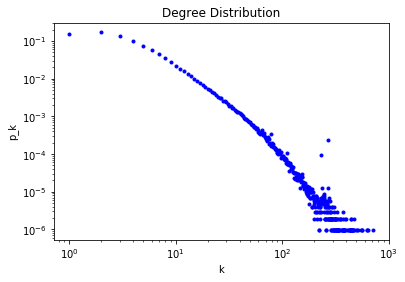

In [11]:
degree_sequence = [d for _, d in g.degree()]
unique, counts = np.unique(degree_sequence, return_counts=True)
counts_map = np.asarray((unique, counts)).T
pdf_empirical = counts_map[:, 1] / np.sum(counts_map[:, 1])

x_line = np.arange(min(degree_sequence), max(degree_sequence))

_, ax = plt.subplots()
ax.loglog(unique, pdf_empirical, 'b.')
# ax.legend(loc='upper right', shadow=True, fontsize='x-large')
plt.title('Degree Distribution')
plt.xlabel('k')
plt.ylabel('p_k')
plt.show()

In [11]:
edge_list_filtered.drop(['first_name_source', 'first_name_target'], inplace=True, axis=1)

KeyError: "['first_name_source' 'first_name_target'] not found in axis"

In [19]:
names = np.concatenate((edge_list_filtered['source'].tolist(), edge_list_filtered['target'].tolist()), axis=None)
genders = np.concatenate((edge_list_filtered['gender_source'].tolist(), edge_list_filtered['gender_target'].tolist()), axis=None)
name_gender_map = dict(zip(names, genders))


In [24]:
nx.set_node_attributes(g, name_gender_map, 'gender')

In [25]:
df = nx.to_pandas_edgelist(g)
df.to_csv()

DegreeView({'Alejandro P. Buchmann': 44, 'Frank Manola': 23, 'Mark F. Hornick': 19, 'Farshad Nayeri': 7, 'Joe D. Morrison': 2, 'Dimitrios Georgakopoulos': 109, 'Sandra Heiler': 8, 'Michael L. Brodie': 44, 'Michael Stonebraker': 209, 'Benjamin Hurwitz': 6, 'Daniel Genkin': 66, 'Daniel Gruss': 39, 'Michael Schwarz 0001': 41, 'Mike Hamburg': 18, 'Moritz Lipp': 30, 'Paul Kocher': 9, 'Stefan Mangard': 62, 'Thomas Prescher 0002': 11, 'Werner Haas': 9, 'Yuval Yarom': 62, 'Christian Stangier': 7, 'Christoph Meinel': 106, 'Helmut Seidl': 45, 'Markus Müller-Olm': 8, 'Varmo Vene': 9, 'Anna Slobodová': 15, 'Alexander Kaplan': 75, 'Rainer Tichatschke': 6, 'Jochen Bern': 3, 'Jordan Gergov': 3, 'Fabio Somenzi': 42, 'Thorsten Theobald': 25, 'Klaus Lux': 11, 'Markus Wiegelmann': 6, 'Klaus Schwettmann': 2, 'Carsten Damm': 24, 'Stasys Jukna': 17, 'Michael Schmitt 0002': 1, 'Gianpiero Cabodi': 38, 'Harald Sack': 96, 'Stefano Quer': 33, 'Dieter Baum': 4, 'Vladimir V. Kalashnikov': 3, 'Klaus Jansen': 83, 'T